In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
from haversine import haversine

In [2]:
os.chdir(os.path.dirname(__file__))

In [3]:
deploy = pd.read_csv('../../data/deployments.csv')
pickup = pd.read_csv('../../data/pickups.csv')
rides  = pd.read_csv('../../data/rides.csv')

In [4]:
deploy.info()
deploy.describe()
deploy.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17969 entries, 0 to 17968
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   task_id             17969 non-null  object
 1   vehicle_id          17969 non-null  object
 2   time_task_created   17969 non-null  object
 3   time_task_resolved  17969 non-null  object
dtypes: object(4)
memory usage: 561.7+ KB


,task_id,vehicle_id,time_task_created,time_task_resolved
count,17969,17969,17969,17969
unique,17969,3920,17966,17967
top,JBMHRfpo7R8Obb27t7E6,IFE0zdS4rkTO4Xj5EZSM,2019-05-11 09:20:51.366 UTC,2019-05-24 13:50:32.87 UTC
freq,1,19,2,2


,task_id,vehicle_id,time_task_created,time_task_resolved
0,6fy0fO6BHW2IvxunS54N,i1Fycyzyi1HeeEN8eVh1,2019-05-19 02:34:31.999 UTC,2019-05-21 04:52:29.113 UTC
1,36AUD64tmGggMdmXLwY3,inxamrBymPp1kKuGoOXE,2019-05-19 03:20:30.842 UTC,2019-05-20 06:38:49.76 UTC
2,TcPf6gwxm98aVufsLcCo,1DfPwD1x6teNIhv8aS3p,2019-05-19 00:39:49.472 UTC,2019-05-19 05:13:56.514 UTC
3,MiHEvPS2yD9UKkcbTLUN,1TkCdPxuKYSg68Ongllz,2019-05-19 04:28:55.896 UTC,2019-05-20 07:00:09.397 UTC
4,wpqaaO3EilBcF943xJYd,STyaEsJk2oiFz1NEJHE7,2019-05-19 06:20:23.947 UTC,2019-05-20 07:55:36.504 UTC


In [5]:
pickup.info()
pickup.describe()
pickup.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18089 entries, 0 to 18088
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   task_id             18089 non-null  object
 1   vehicle_id          18089 non-null  object
 2   qr_code             18089 non-null  object
 3   time_task_created   18089 non-null  object
 4   time_task_resolved  18089 non-null  object
dtypes: object(5)
memory usage: 706.7+ KB


,task_id,vehicle_id,qr_code,time_task_created,time_task_resolved
count,18089,18089,18089,18089,18089
unique,18089,4196,4196,18089,18089
top,4Sa7B6f5htctNTfgkS9j,ZS08r6re6o1yJ3QuCAei,TVEWB7,2019-05-01 20:31:23.999 UTC,2019-05-18 09:13:53.242 UTC
freq,1,19,19,1,1


,task_id,vehicle_id,qr_code,time_task_created,time_task_resolved
0,yV4kXBtAx6GNRcJDLsF2,JkDkmUHoZ4ngg7hAx0F4,XXBGC5,2019-05-04 21:30:07.089 UTC,2019-05-04 21:30:07.883 UTC
1,xGAnYaxqoyGUa8RFcaTr,NpbLgU80Rliumo1QkoeZ,NWM2QA,2019-05-04 00:07:17.13 UTC,2019-05-05 16:11:24.233 UTC
2,MdkXjdQEW0BfFssY1w44,qHbfAktQ2MYfme75EhBM,M43B0N,2019-05-04 18:36:10.529 UTC,2019-05-04 18:36:10.998 UTC
3,p23c48p07N5fU3e4HOdx,mcRXxmiFF6HrxJ5is2a1,ZC85M1,2019-05-04 18:09:22.712 UTC,2019-05-04 18:09:23.061 UTC
4,XfJqWe0fnFeHxB44T2wG,jG0LWBJM87zpBajNWeS7,Z84V6J,2019-05-04 16:42:35.639 UTC,2019-05-04 16:50:26.062 UTC


In [6]:
rides.info()
rides.describe()
rides.head()
rides.apply(pd.Series.nunique)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79042 entries, 0 to 79041
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ride_id          79042 non-null  object 
 1   vehicle_id       79042 non-null  object 
 2   time_ride_start  79042 non-null  object 
 3   time_ride_end    79042 non-null  object 
 4   start_lat        79042 non-null  float64
 5   start_lng        79042 non-null  float64
 6   end_lat          79042 non-null  float64
 7   end_lng          79042 non-null  float64
 8   gross_amount     78971 non-null  float64
dtypes: float64(5), object(4)
memory usage: 5.4+ MB


,start_lat,start_lng,end_lat,end_lng,gross_amount
count,"79,042.00","79,042.00","79,042.00","79,042.00","78,971.00"
mean,48.86,2.32,48.85,2.32,3.36
std,0.02,0.03,0.55,0.04,2.43
min,48.61,2.02,0.00,0.00,1.00
25%,48.85,2.30,48.85,2.30,1.81
50%,48.86,2.32,48.86,2.32,2.60
75%,48.87,2.34,48.87,2.35,4.02
max,49.06,2.55,49.06,2.55,80.93


,ride_id,vehicle_id,time_ride_start,time_ride_end,start_lat,start_lng,end_lat,end_lng,gross_amount
0,dVPK7fEkGfd3HJiYRMkj,f42vVrTOJh7yVYJACDCv,2019-05-02 19:24:01.692 UTC,2019-05-02 19:30:43.433 UTC,48.83,2.38,48.83,2.36,2.00
1,y9xR90cTsRdWkC2JuO0r,ZWuRqR3eNjRVEQlHPsJy,2019-05-02 12:32:39.928 UTC,2019-05-02 12:52:42.333 UTC,48.84,2.30,48.83,2.33,4.00
2,GSX8MZkpWEttApiFsELL,j8JnGWoM5bohbxAOzm42,2019-05-02 21:59:50.218 UTC,2019-05-02 22:08:13.39 UTC,48.89,2.29,48.89,2.31,2.25
3,l5npy2l9IyXmaCHCbcSu,ghh4d9VJGjTMxgW54etd,2019-05-02 15:16:37.857 UTC,2019-05-02 15:26:40.932 UTC,48.84,2.27,48.85,2.28,2.50
4,rpCjuQyIaYd4Ox1wu7Pp,yiQ3vmhhMGLr0hiws6Kq,2019-05-02 16:22:29.716 UTC,2019-05-02 16:49:16.348 UTC,48.84,2.35,48.84,2.32,5.01


ride_id            79042
vehicle_id          3862
time_ride_start    79038
time_ride_end      79040
start_lat          47516
start_lng          59486
end_lat            48914
end_lng            60728
gross_amount        1636
dtype: int64

In [7]:
events = (pd
    .concat([
        (rides
            .assign(
                kms=lambda df: df.apply(lambda row:
                    haversine((row['start_lat'], row['start_lng']), (row['end_lat'], row['end_lng'])), 1),
                mins=lambda df:
                    (
                      pd.to_datetime(rides.time_ride_end, format="%Y-%m-%d %H:%M:%S.%f %Z", errors='coerce')
                    - pd.to_datetime(rides.time_ride_start,   format="%Y-%m-%d %H:%M:%S.%f %Z", errors='coerce')
                    ).dt.seconds / 60
            )
            .set_index(['ride_id', 'vehicle_id', 'gross_amount', 'kms', 'mins'])[['time_ride_start', 'time_ride_end']].stack()
            .reset_index().rename(columns={'level_5':'event', 0:'ts'})
            .replace({'time_ride_start': 'ride_start', 'time_ride_end': 'ride_end'})
        ),
        (pickup
            .set_index(['task_id', 'vehicle_id'])[['time_task_created', 'time_task_resolved']].stack()
            .reset_index().rename(columns={'task_id': 'pickup_id', 'level_2': 'event', 0:'ts'})
            .replace({'time_task_created': 'pickup_start', 'time_task_resolved': 'pickup_end'})
        ),
        (deploy
            .set_index(['task_id', 'vehicle_id'])[['time_task_created', 'time_task_resolved']].stack()
            .reset_index().rename(columns={'task_id': 'deploy_id', 'level_2': 'event', 0:'ts'})
            .replace({'time_task_created': 'deploy_start', 'time_task_resolved': 'deploy_end'})
        )
    ])
    [['vehicle_id', 'deploy_id', 'pickup_id', 'ride_id', 'gross_amount', 'kms', 'mins', 'event', 'ts']]
    .sort_values(['vehicle_id', 'ts'])
    .reset_index(drop=True)
    # `status`-column to show the latest service event, eg. `deploy_end` means it's available on the street.
    .assign(status=lambda df: df.event.where(~df.event.str.contains('ride')))
    .assign(status=lambda df: df.groupby('vehicle_id').status.ffill())
)
events.head()

,vehicle_id,deploy_id,pickup_id,ride_id,gross_amount,kms,mins,event,ts,status
0,00TW9JELAItFazRxej7f,4VcfrC79JKgkXK6p3kNJ,NaN,NaN,NaN,NaN,NaN,deploy_start,2019-04-27 10:44:42.154 UTC,deploy_start
1,00TW9JELAItFazRxej7f,4VcfrC79JKgkXK6p3kNJ,NaN,NaN,NaN,NaN,NaN,deploy_end,2019-05-01 05:45:29.133 UTC,deploy_end
2,00TW9JELAItFazRxej7f,NaN,NaN,yqe0ImYkRmrcmdYzfLf9,1.22,0.20,1.47,ride_start,2019-05-01 12:18:03.616 UTC,deploy_end
3,00TW9JELAItFazRxej7f,NaN,NaN,yqe0ImYkRmrcmdYzfLf9,1.22,0.20,1.47,ride_end,2019-05-01 12:19:31.701 UTC,deploy_end
4,00TW9JELAItFazRxej7f,NaN,NaN,8Fn4pWtZh6oAcvDzBeaX,2.93,1.01,12.87,ride_start,2019-05-01 14:37:06.089 UTC,deploy_end


 # Check assumptions

 ## Invalid rides

In [8]:
offending_rides = events[events.ride_id.notnull() & ~(events.status == 'deploy_end') & events.status.notnull()]
offending_rides.groupby(['event', 'status']).size()
offending_rides.describe()

event       status      
ride_end    pickup_end       311
            pickup_start    6421
ride_start  pickup_end       384
dtype: int64

,gross_amount,kms,mins
count,"7,083.00","7,116.00","7,108.00"
mean,4.77,3.54,25.05
std,3.21,91.12,21.25
min,1.00,0.00,0.03
25%,2.63,0.76,10.90
50%,3.88,1.67,19.18
75%,5.88,2.95,32.43
max,54.64,"5,439.30",357.62


 Quite some rides ending after a service pickup.

 Other discrepancies possibly due to both eventual consistency in the source data, and invalid rides as well.

 ## Lack of `gross_amount`?

In [9]:
no_amount = events[events.gross_amount.isnull() & events.ride_id.notnull()]
no_amount.info()
no_amount.describe()
no_amount.ride_id.nunique(), offending_rides.ride_id.nunique(), len(set(no_amount.ride_id) & set(offending_rides.ride_id))

<class 'pandas.core.frame.DataFrame'>
Int64Index: 142 entries, 980 to 230062
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   vehicle_id    142 non-null    object 
 1   deploy_id     0 non-null      object 
 2   pickup_id     0 non-null      object 
 3   ride_id       142 non-null    object 
 4   gross_amount  0 non-null      float64
 5   kms           142 non-null    float64
 6   mins          142 non-null    float64
 7   event         142 non-null    object 
 8   ts            142 non-null    object 
 9   status        142 non-null    object 
dtypes: float64(3), object(7)
memory usage: 12.2+ KB


,gross_amount,kms,mins
count,0.00,142.00,142.00
mean,NaN,2.63,87.58
std,NaN,2.30,26.56
min,NaN,0.01,50.23
25%,NaN,0.81,67.18
50%,NaN,2.13,82.70
75%,NaN,3.94,102.56
max,NaN,9.36,190.53


(71, 6732, 33)

 Half of rides without an amount is also and offending ride.
 Lack of amount is unrelated to distance.

 ## Pricing

<AxesSubplot:xlabel='gross_amount', ylabel='kms'>

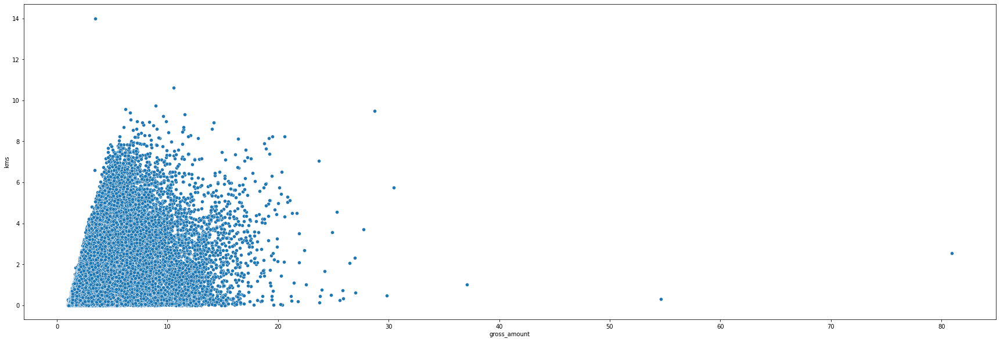

In [10]:
sns.scatterplot(
    data=(events
        [events.kms < 20]
        .drop_duplicates(subset=['ride_id'])
    ),
    x='gross_amount',
    y='kms'
)

<AxesSubplot:xlabel='gross_amount', ylabel='mins'>

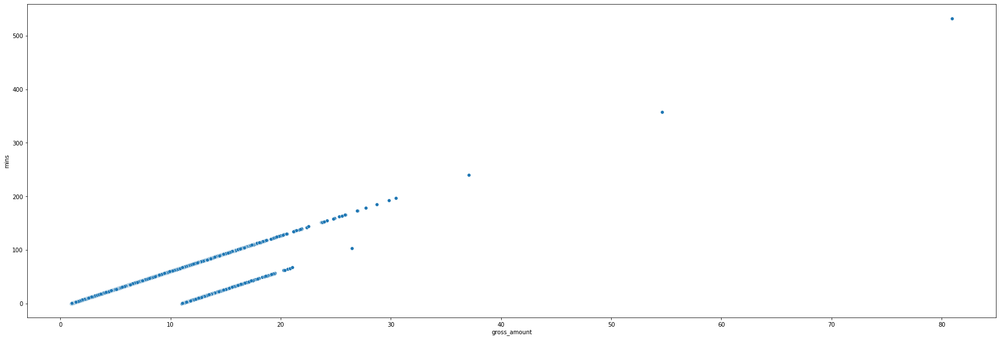

In [11]:
sns.scatterplot(
    data=(events
        [events.kms < 20]
        .drop_duplicates(subset=['ride_id'])
    ),
    x='gross_amount',
    y='mins'
)

 # QR-codes

In [12]:
(pickup.groupby(['vehicle_id']).qr_code.nunique() == 1).all()

True

 QR-codes map to vehicle IDs 1:1.

 # Prep data quality checks

In [13]:
events.select_dtypes('object').apply(lambda c: c.dropna().str.len()).describe()
pickup.qr_code.dropna().map(len).describe()

,vehicle_id,deploy_id,pickup_id,ride_id,event,ts,status
count,"230,200.00","35,938.00","36,178.00","158,084.00","230,200.00","230,200.00","226,104.00"
mean,20.00,20.00,20.00,20.00,9.63,26.90,10.38
std,0.00,0.00,0.00,0.00,1.36,0.35,0.78
min,20.00,20.00,20.00,20.00,8.00,23.00,10.00
25%,20.00,20.00,20.00,20.00,8.00,27.00,10.00
50%,20.00,20.00,20.00,20.00,10.00,27.00,10.00
75%,20.00,20.00,20.00,20.00,10.00,27.00,10.00
max,20.00,20.00,20.00,20.00,12.00,27.00,12.00


count              18,089.00
mean                    6.00
std                     0.00
min                     6.00
25%                     6.00
50%                     6.00
75%                     6.00
max                     6.00
Name: qr_code, dtype: float64

 All id-columns are made of 20 character-long strings.
 QR-code column made of 6 characters.